# 0. Постановка задачи

В датасете *covertype* ставится задача определения вида лесного покрова. В силу того, что у каждого типа дерева существуют свои правила ухода, но не в любое место крупного леса может быть просто быстро доставить специалиста, способного определить типа дерева, была поставлена задача определения этого типа по исключительно каартографическим параметрам. 

Следующие параметры были собраны для множества квадратов 30x30 метров в разных точках лесов:

| Название признака | Описание | Единица измерения |
| :- | :-: | --- |
| elevation | высота над уровнем моря | метры |
| aspect | экспозиция склона, азимут в направлении которого ориентирована поверхность (склон) | градусы |
| slope | склон | градусы |
| hor_dist_water | расстояние до ближайшего водоёма по горизонтали | метры |
| ver_dist_water | расстояние до ближайшего водоёма по вертикали | метры |
| hor_dist_road | расстояние до ближайшей проезжей части по горизонтали | метры |
| hillshade_9 | индекс отмывки в 9 часов утра во время летнего солнцестояния | - |
| hillshade_noon | индекс отмывки в полдень во время летнего солнцестояния | - |
| hillshade_15 | индекс отмывки в 15 часов дня во время летнего солнцестояния | - |
| hor_dist_fire | расстояние до ближайших очагов лесных пожаров по горизонтали | метры |

Также в датасете присутствуют 40 категориальных признаков, отвечвющих за тип почвы встречающийся в рассматриваемом квадрате (были заранее обработаны методом one-hot encoding).

Наконец в последней колонке *type* содержится обозначения одного из семи типов определяемого дерева.

# 1. Чтение данных

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_predict, cross_val_score, cross_validate

from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import Pipeline
from sklearn.metrics import ConfusionMatrixDisplay
from imblearn.under_sampling import RandomUnderSampler
from sklearn.compose import ColumnTransformer
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

In [28]:
import warnings
warnings.filterwarnings('ignore')


In [3]:
df = pd.read_csv('covtype.csv', header=0)
df

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,2596,51,3,258,0,510,221,232,148,6279,...,0,0,0,0,0,0,0,0,0,5
1,2590,56,2,212,-6,390,220,235,151,6225,...,0,0,0,0,0,0,0,0,0,5
2,2804,139,9,268,65,3180,234,238,135,6121,...,0,0,0,0,0,0,0,0,0,2
3,2785,155,18,242,118,3090,238,238,122,6211,...,0,0,0,0,0,0,0,0,0,2
4,2595,45,2,153,-1,391,220,234,150,6172,...,0,0,0,0,0,0,0,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
581007,2396,153,20,85,17,108,240,237,118,837,...,0,0,0,0,0,0,0,0,0,3
581008,2391,152,19,67,12,95,240,237,119,845,...,0,0,0,0,0,0,0,0,0,3
581009,2386,159,17,60,7,90,236,241,130,854,...,0,0,0,0,0,0,0,0,0,3
581010,2384,170,15,60,5,90,230,245,143,864,...,0,0,0,0,0,0,0,0,0,3


# 2. Визуализация

Для наглядной визуализации данных будет полезно посчитать корелляцию числовых признаков.

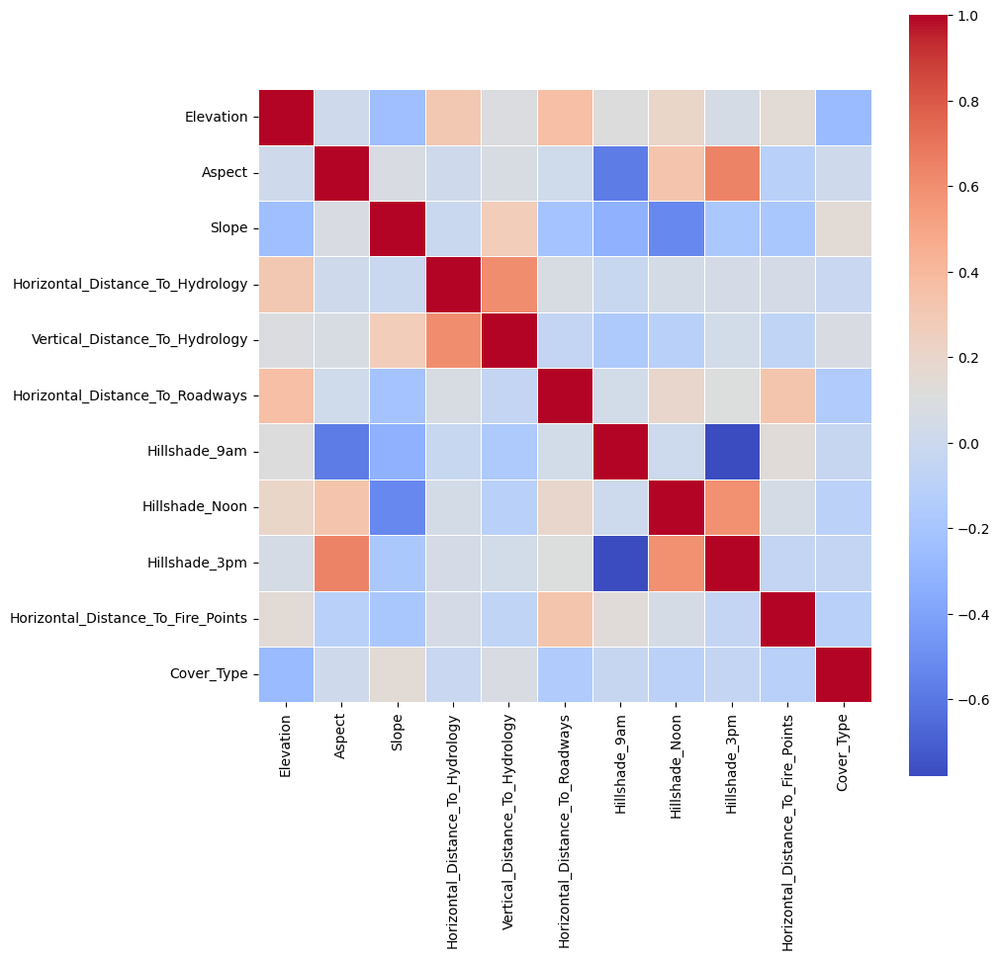

In [4]:
fig, ax = plt.subplots(figsize=(10,10))

corr_mat = pd.concat([df.iloc[ : , :10], df['Cover_Type']], axis=1).corr()
sns.heatmap(corr_mat, square=True, cmap='coolwarm', linewidths=.5, ax=ax)
pass

Выделим признаки с средней корреляцией и построим графики их зависимости:

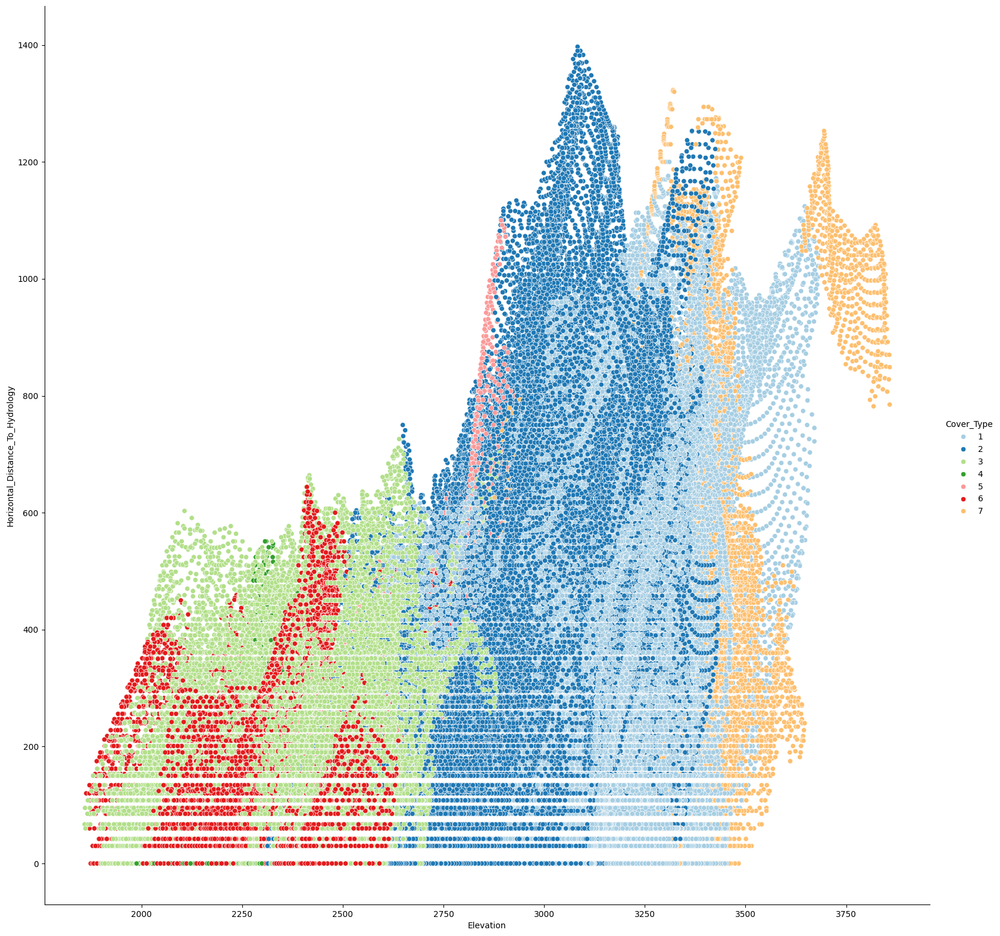

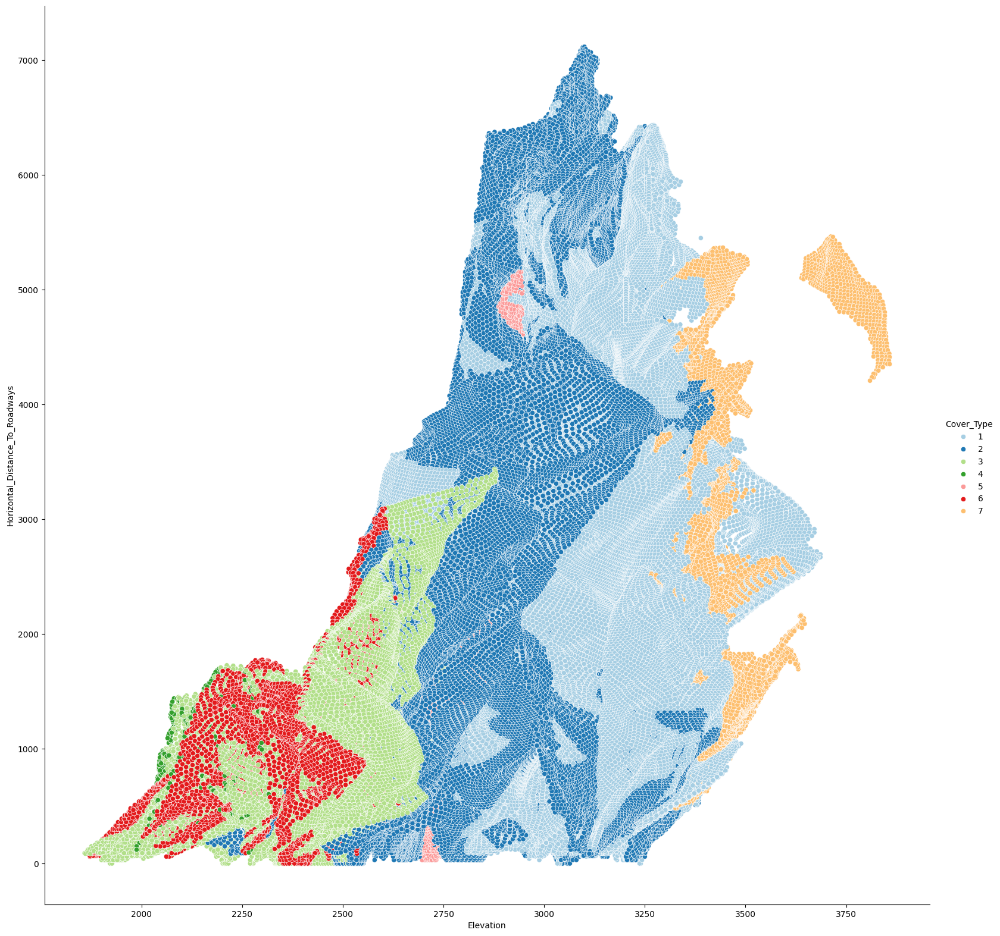

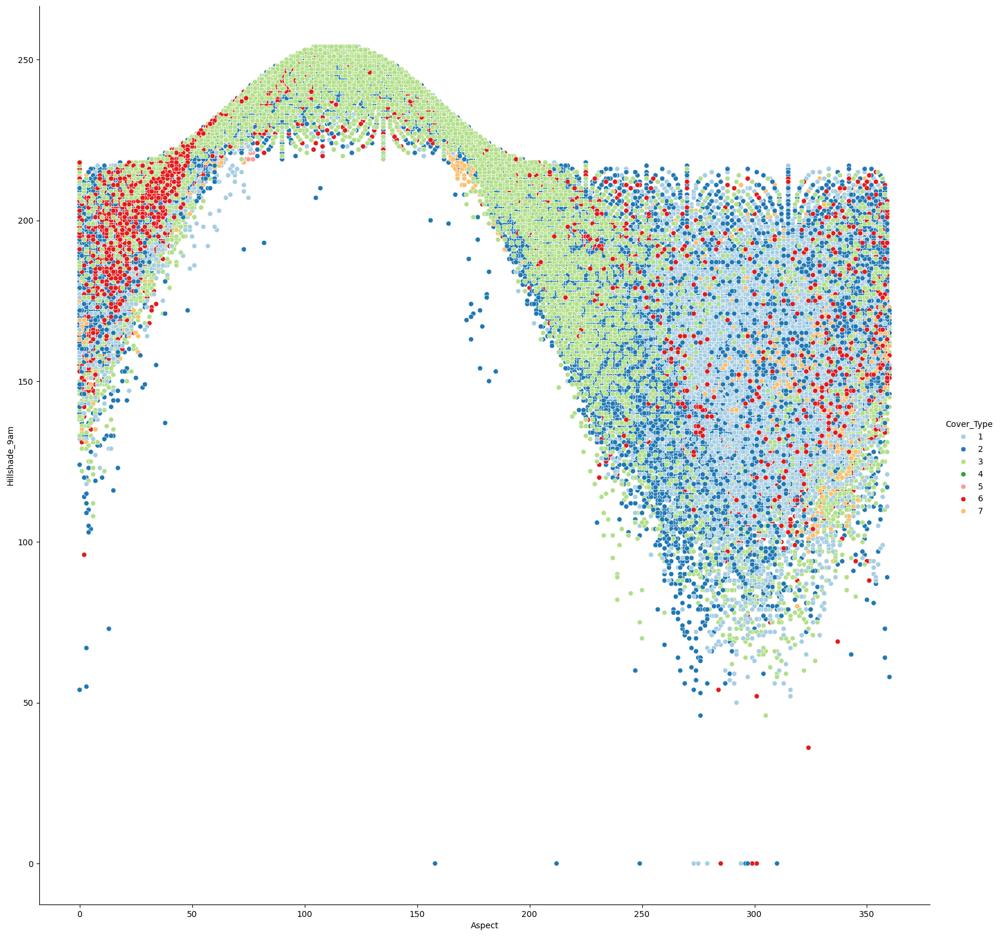

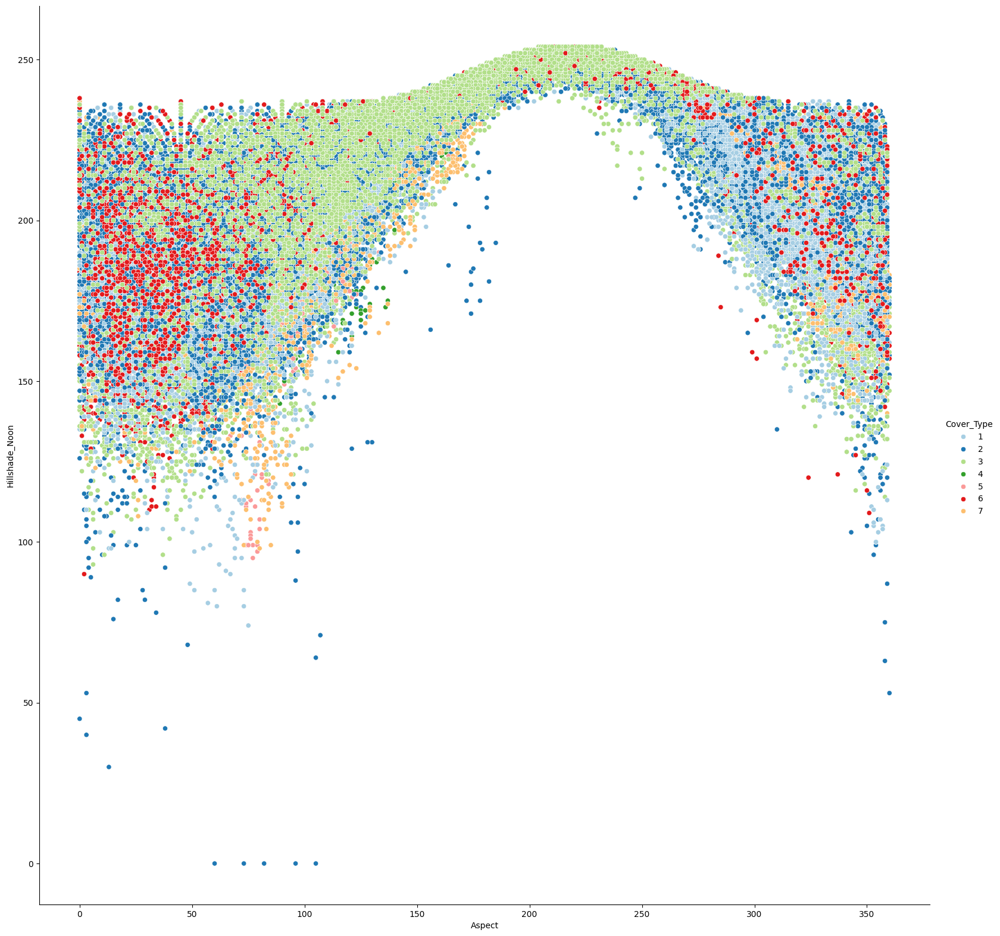

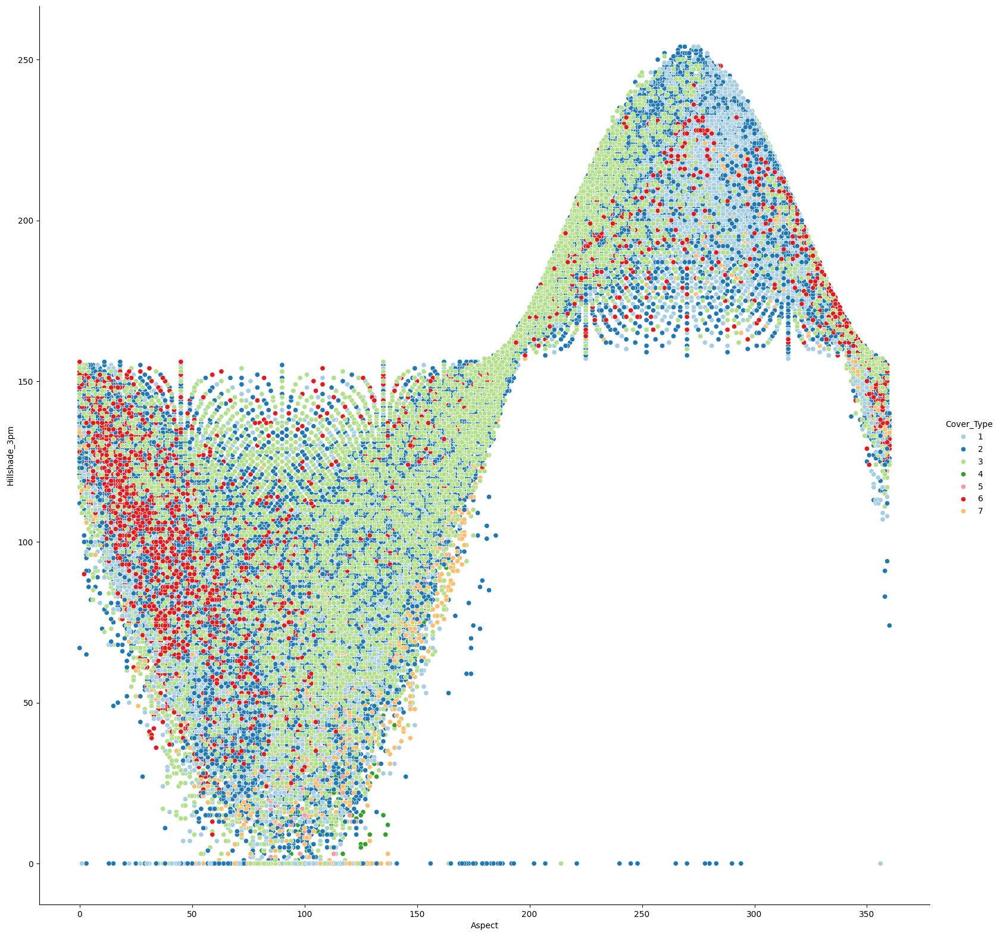

...

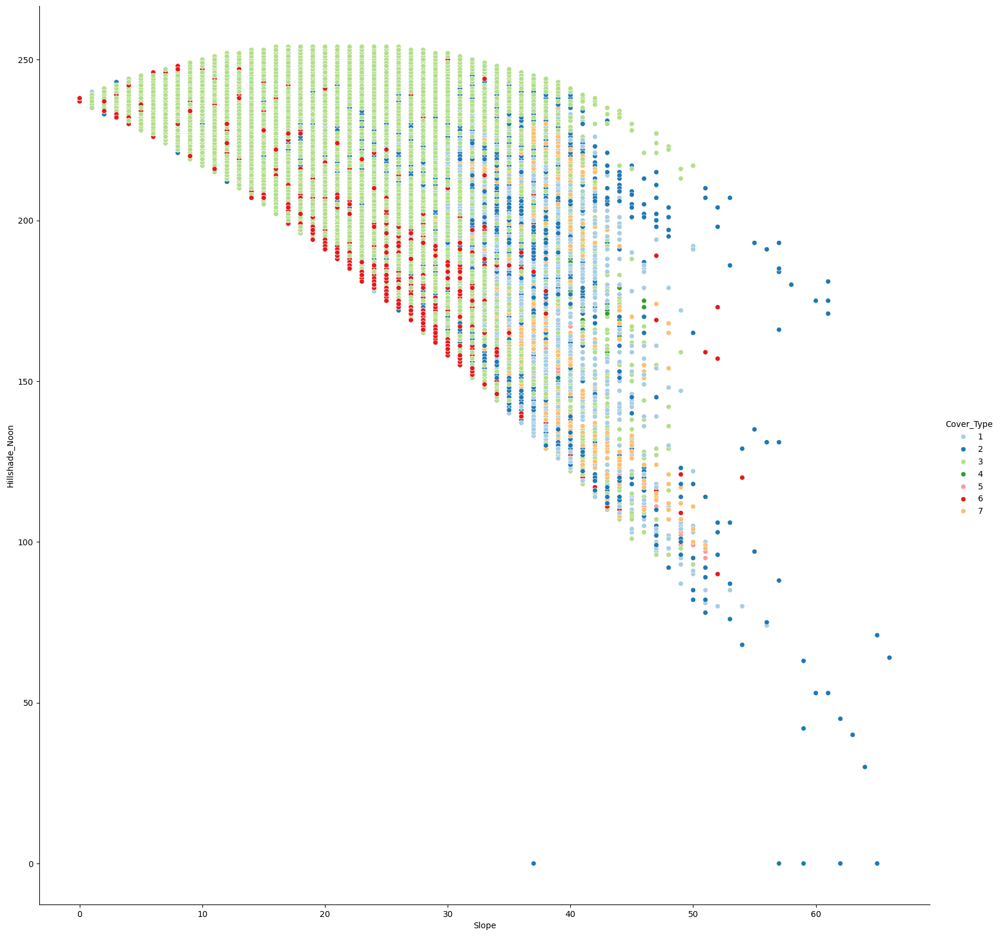

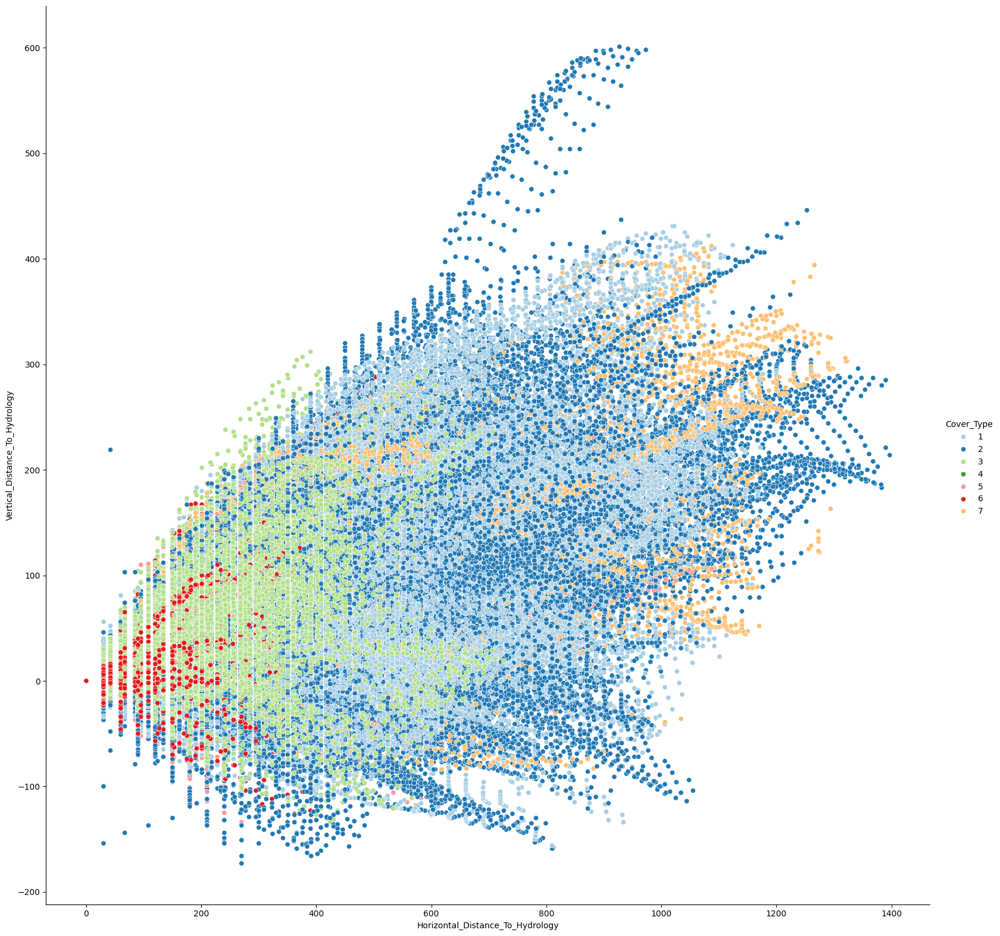

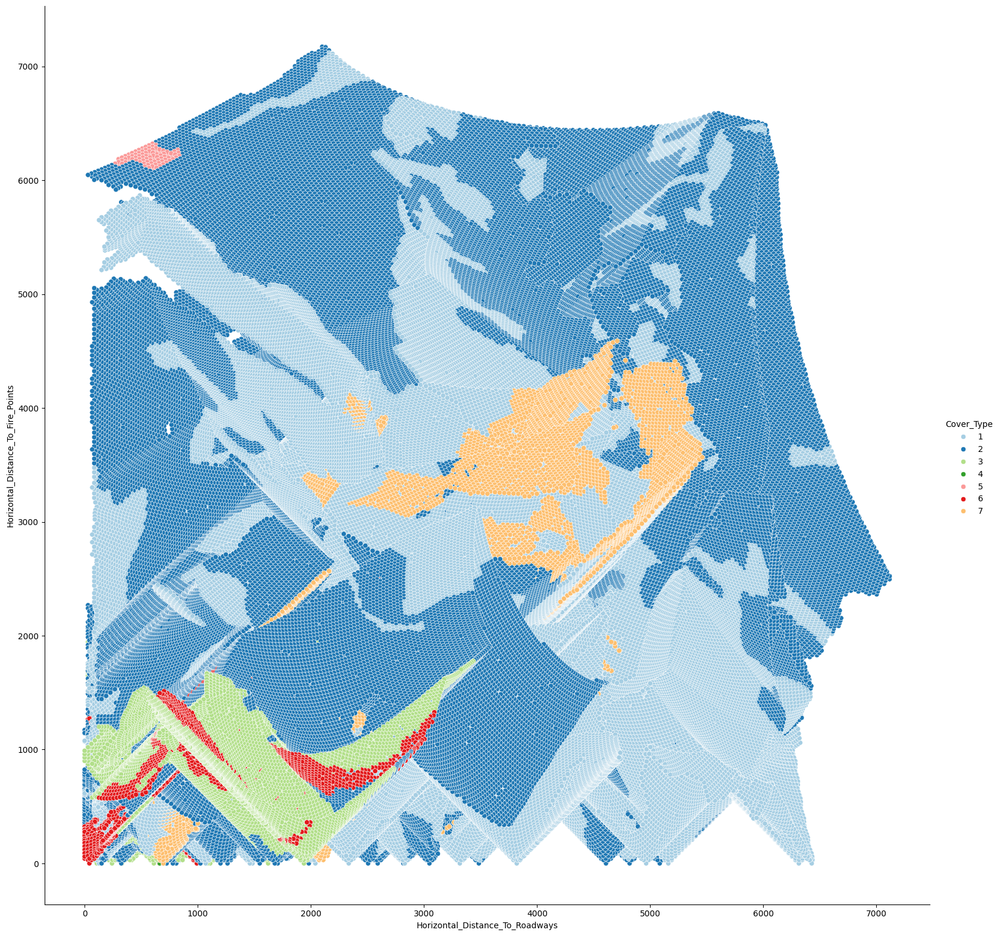

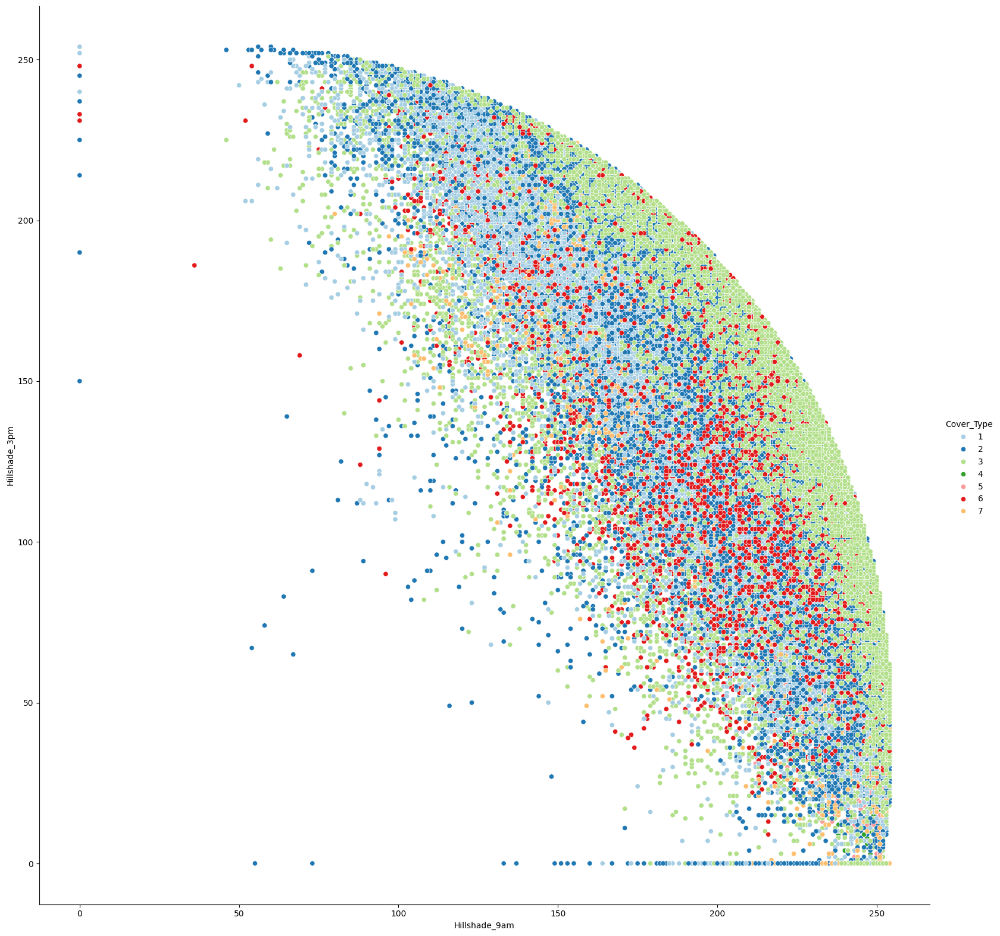

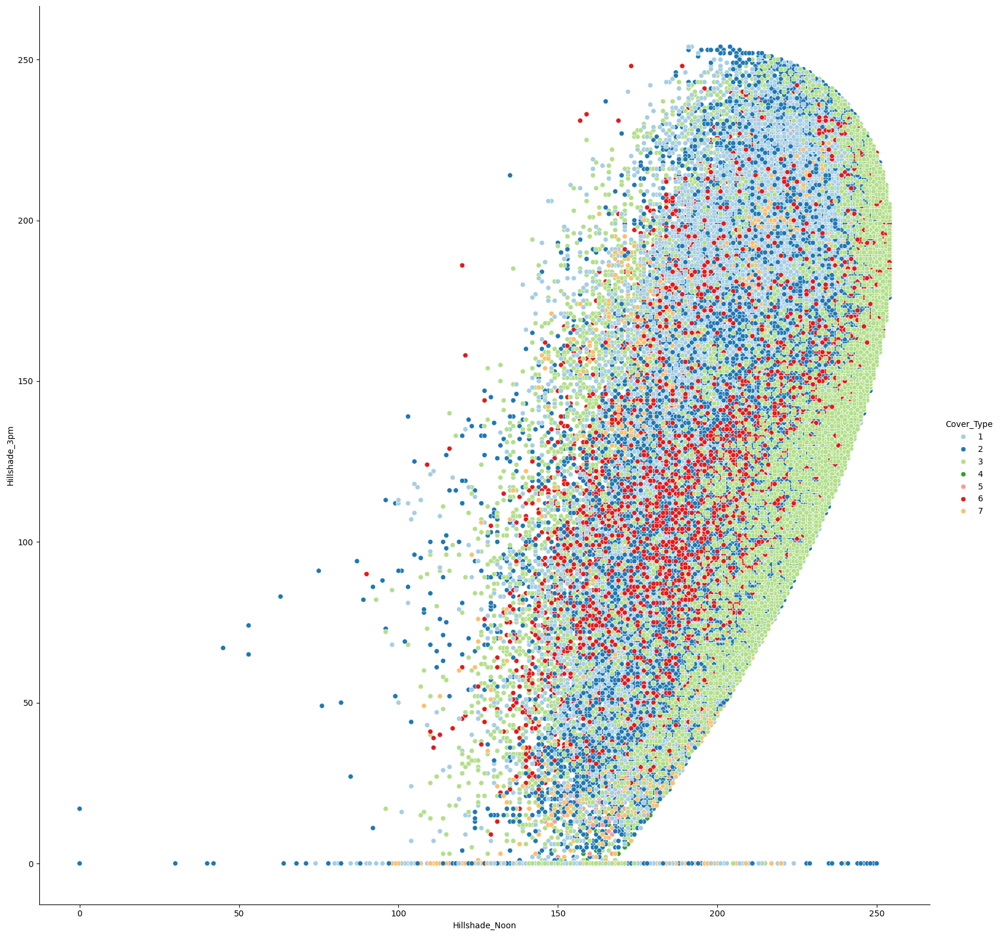

In [14]:
cols=df.columns
feats = df.iloc[:,:10] 

threshold = 0.3

corr_list = []
for i in range(10):
    for j in range(i + 1, 10):
        if (corr_mat.iloc[i,j] >= threshold and corr_mat.iloc[i,j] < 1) or (corr_mat.iloc[i,j] < 0 and corr_mat.iloc[i,j] <= -threshold):
            corr_list.append([corr_mat.iloc[i,j],i,j])

for _,i,j in corr_list:
    sns.pairplot(df, hue="Cover_Type", height=16, x_vars=cols[i],y_vars=cols[j], palette="Paired")
    plt.show()

На диаграммах можно обнаружить множество занимательных зависимостей, по большей степени связанных с уклоном и экспозицией склона, влияющих на освещеннность поверхности в разное время суток.

Прочие числовые характеристики:

In [5]:
df.describe()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
count,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,...,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000,581012.000000
mean,2959.365301,155.656807,14.103704,269.428217,46.418855,2350.146611,212.146049,223.318716,142.528263,1980.291226,...,0.090392,0.077716,0.002773,0.003255,0.000205,0.000513,0.026803,0.023762,0.015060,2.051471
std,279.984734,111.913721,7.488242,212.549356,58.295232,1559.254870,26.769889,19.768697,38.274529,1324.195210,...,0.286743,0.267725,0.052584,0.056957,0.014310,0.022641,0.161508,0.152307,0.121791,1.396504
min,1859.000000,0.000000,0.000000,0.000000,-173.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2809.000000,58.000000,9.000000,108.000000,7.000000,1106.000000,198.000000,213.000000,119.000000,1024.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,2996.000000,127.000000,13.000000,218.000000,30.000000,1997.000000,218.000000,226.000000,143.000000,1710.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,3163.000000,260.000000,18.000000,384.000000,69.000000,3328.000000,231.000000,237.000000,168.000000,2550.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
max,3858.000000,360.000000,66.000000,1397.000000,601.000000,7117.000000,254.000000,254.000000,254.000000,7173.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


# 3. Обработка пропущенных значений

In [6]:
df.isna().any().any()

False

Пропущенных значений нет

# 4. Обработка категориальных признаков

In [7]:
set(df.dtypes)

{dtype('int64')}

Все категориальные признаки были обработаны заранее. Данные о типе почвы были обработаны с помощью one-hot encoding. Однако, некоторые из типов встречаются достаточно редко и не несут существенного вклада. Рассмотрим признаки с нименьшим разбросом и оставим только те, у которых он >= 0.1:

In [8]:
stdescript = df.describe().T
todrop = list(stdescript.sort_values(by='std', ascending=False).loc[stdescript['std'] < 0.1].index)
todrop

['Soil_Type3',
 'Soil_Type19',
 'Soil_Type17',
 'Soil_Type1',
 'Soil_Type16',
 'Soil_Type26',
 'Soil_Type18',
 'Soil_Type35',
 'Soil_Type34',
 'Soil_Type5',
 'Soil_Type9',
 'Soil_Type27',
 'Soil_Type28',
 'Soil_Type21',
 'Soil_Type14',
 'Soil_Type25',
 'Soil_Type37',
 'Soil_Type8',
 'Soil_Type36',
 'Soil_Type7',
 'Soil_Type15']

Также удалим один из кореллированных признаков - Hillshade_3pm, так как он заметно кореллирован с тремя другими и не внесет особо значительного вклада.

In [9]:
todrop.append('Hillshade_3pm')
ddf = df.drop(todrop, axis=1)
ddf

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Horizontal_Distance_To_Fire_Points,Wilderness_Area1,...,Soil_Type24,Soil_Type29,Soil_Type30,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,2596,51,3,258,0,510,221,232,6279,1,...,0,1,0,0,0,0,0,0,0,5
1,2590,56,2,212,-6,390,220,235,6225,1,...,0,1,0,0,0,0,0,0,0,5
2,2804,139,9,268,65,3180,234,238,6121,1,...,0,0,0,0,0,0,0,0,0,2
3,2785,155,18,242,118,3090,238,238,6211,1,...,0,0,1,0,0,0,0,0,0,2
4,2595,45,2,153,-1,391,220,234,6172,1,...,0,1,0,0,0,0,0,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
581007,2396,153,20,85,17,108,240,237,837,0,...,0,0,0,0,0,0,0,0,0,3
581008,2391,152,19,67,12,95,240,237,845,0,...,0,0,0,0,0,0,0,0,0,3
581009,2386,159,17,60,7,90,236,241,854,0,...,0,0,0,0,0,0,0,0,0,3
581010,2384,170,15,60,5,90,230,245,864,0,...,0,0,0,0,0,0,0,0,0,3


Обработка выбросов:

In [10]:
ncols = np.clip(len(ddf.columns), 0, 10)
cols = ddf.columns[:ncols]
drop = (ddf[cols[0]] < ddf[cols[0]].quantile(0.005)) | (ddf[cols[0]] > ddf[cols[0]].quantile(0.995))
for i in range(1, ncols):
    drop = drop | (ddf[cols[i]] < ddf[cols[i]].quantile(0.005)) | (ddf[cols[i]] > ddf[cols[i]].quantile(0.995))
rtd = ddf[drop].index
ddf = ddf.drop(index = rtd)
ddf.shape

(549081, 33)

Под критерий выбросов попала 31 931 наблюдений - 5%

In [11]:
ddf['Cover_Type'].value_counts()

Cover_Type
2    269936
1    203450
3     30607
7     17934
6     15734
5      9084
4      2336
Name: count, dtype: int64

Как можно заметить, данные сильно несбалансированы. Далее будет проведена балансировка классов.

# Обучение модели


При обучении модели будут использоваться следующие инструменты:
- *RandomUnderSampler* - самая простая функция для борьбы с несбалансированностью классов путем андерсемплинга (данных достаточно много для применения этого метода)
- *StandardScaler* - функция для страндартизирования признаков
- *GridSearchCV* - функция, проводящая перебор гиперпараметров и выбирающая показавшие себя лучше всего во время кросс-валидации

При обучении модели будут использоваться следующие классификаторы:
- *KNeighborsClassifier*
- *DecisionTreeClassifier*
- *RandomForestClassifier*

In [12]:
X = ddf
y = ddf['Cover_Type']

In [13]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=17)

In [14]:
ct = ColumnTransformer(transformers=[
        ('Scaler', StandardScaler(), X_test.columns[:10])
    ], remainder='passthrough')

Для начала найдем оптимальное число соседей для KNN:

In [79]:
neighbors = np.arange(1,7)
train = []
test = []
for i,k in enumerate(neighbors):
    knn = Pipeline([('undersampler', RandomUnderSampler()), ('transformer', ct), ('classifier', KNeighborsClassifier(n_neighbors=k, n_jobs=-1))])
    knn.fit(X_train, y_train)
    train.append(knn.score(X_train, y_train))
    test.append(knn.score(X_test, y_test))
    print(f'{k} done')

1 done
2 done
3 done
4 done
5 done
6 done


Text(0, 0.5, 'Accuracy')

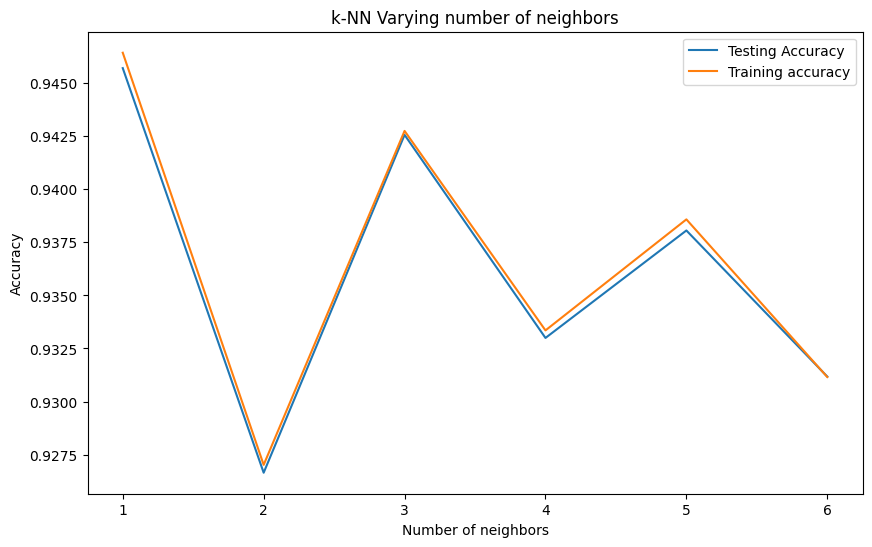

In [80]:
plt.figure(figsize=(10,6))
plt.title('k-NN Varying number of neighbors')
plt.plot(neighbors, test, label='Testing Accuracy')
plt.plot(neighbors, train, label='Training accuracy')
plt.legend()
plt.xlabel('Number of neighbors')
plt.ylabel('Accuracy')

Как можно заметить, оптимальным вариантом будет 1 сосед

In [82]:
pipe = Pipeline([('undersampler', RandomUnderSampler()), ('transformer', ct), ('classifier', KNeighborsClassifier(n_neighbors=1, n_jobs=-1))])
pipe.fit(X_train,y_train)
pipe.score(X_train,y_train)

0.9522864219629719

KNN показал очень хороший результат как на тестовой, так и на обучающей выборке. Построим матрицу рассогласования:

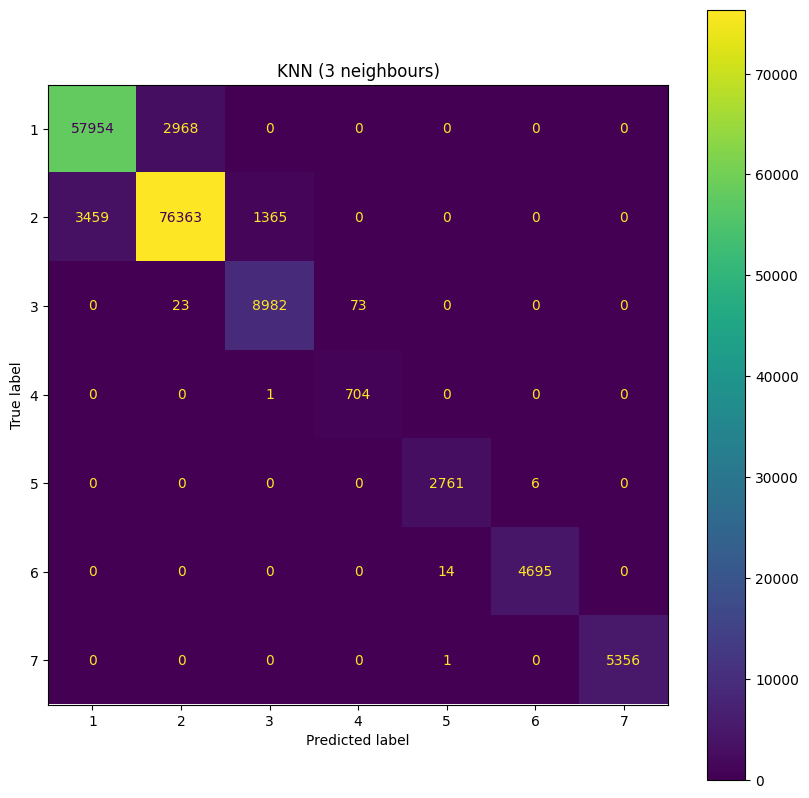

In [84]:
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title(f'KNN (3 neighbours)')
ConfusionMatrixDisplay.from_estimator(pipe, X_test,y_test, ax=ax)  
plt.show()

Попробуем наивный байесовский классификатор:

In [140]:
pipe = Pipeline([('undersampler', RandomUnderSampler()), ('transformer', ct), ('classifier', GaussianNB())])
cross_val_score(pipe, X, y, scoring='accuracy', n_jobs = -1, cv=10, error_score="raise")

array([1.        , 1.        , 0.99987251, 1.        , 1.        ,
       1.        , 0.98663218, 1.        , 0.99745028, 1.        ])

Как и ожидалось, классификатор показал себя отлично на датасете с очень большой выборкой.

Несколько других классификаторов:

In [148]:
# RandomForestClassifier
depth = np.arange(2,30)
train = []
test = []
for i,k in enumerate(depth):
    knn = Pipeline([('undersampler', RandomUnderSampler()), ('transformer', ct), ('classifier', RandomForestClassifier(max_depth=k, n_jobs=-1))])
    knn.fit(X_train, y_train)
    train.append(knn.score(X_train, y_train))
    test.append(knn.score(X_test, y_test))
    print(f'{k} done')

2 done
3 done
4 done
5 done
6 done
7 done
8 done
9 done
10 done
11 done
12 done
13 done
14 done
15 done
16 done
17 done
18 done
19 done
20 done
21 done
22 done
23 done
24 done
25 done
26 done
27 done
28 done
29 done


Text(0, 0.5, 'Accuracy')

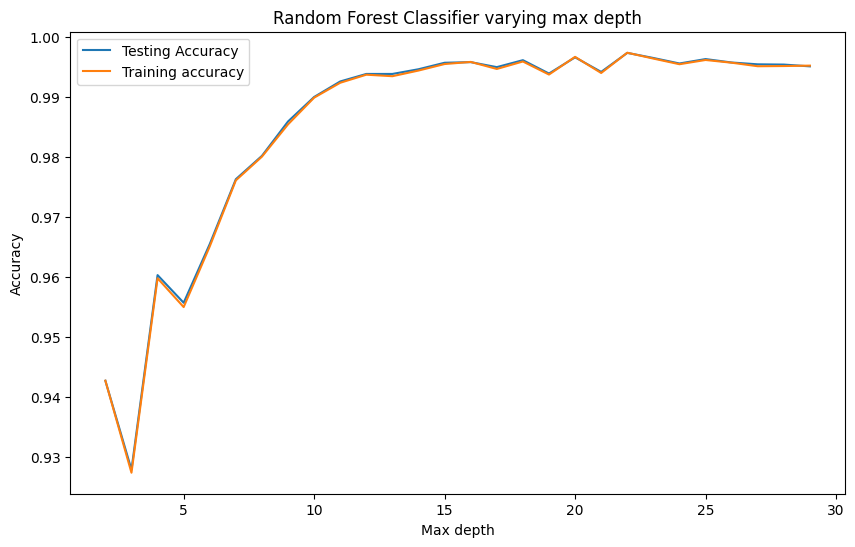

In [149]:
plt.figure(figsize=(10,6))
plt.title('Random Forest Classifier varying max depth')
plt.plot(depth, test, label='Testing Accuracy')
plt.plot(depth, train, label='Training accuracy')
plt.legend()
plt.xlabel('Max depth')
plt.ylabel('Accuracy')

Наблюдается недообучение в начале, переобучение отсутствует

In [150]:
pipe = Pipeline([('undersampler', RandomUnderSampler()), ('transformer', ct), ('classifier', RandomForestClassifier(n_jobs=-1))])
clf = GridSearchCV(pipe, {'classifier__max_depth':range(8, 25),'classifier__n_estimators':[90, 100, 110, 120]}, scoring='f1', refit=True, n_jobs=-1)
clf.fit(X,y)
cross_val_score(clf.best_estimator_, X, y, scoring='accuracy', n_jobs = -1, cv=5, error_score="raise")

array([0.994591  , 0.99403548, 0.98425548, 0.96427661, 0.96888432])

In [152]:
clf.best_estimator_

Pipeline(steps=[('undersampler', RandomUnderSampler()),
                ('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('Scaler', StandardScaler(),
                                                  Index(['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_9am', 'Hillshade_Noon', 'Horizontal_Distance_To_Fire_Points',
       'Wilderness_Area1'],
      dtype='object'))])),
                ('classifier',
                 RandomForestClassifier(max_depth=8, n_estimators=90,
                                        n_jobs=-1))])

<function matplotlib.pyplot.show(close=None, block=None)>

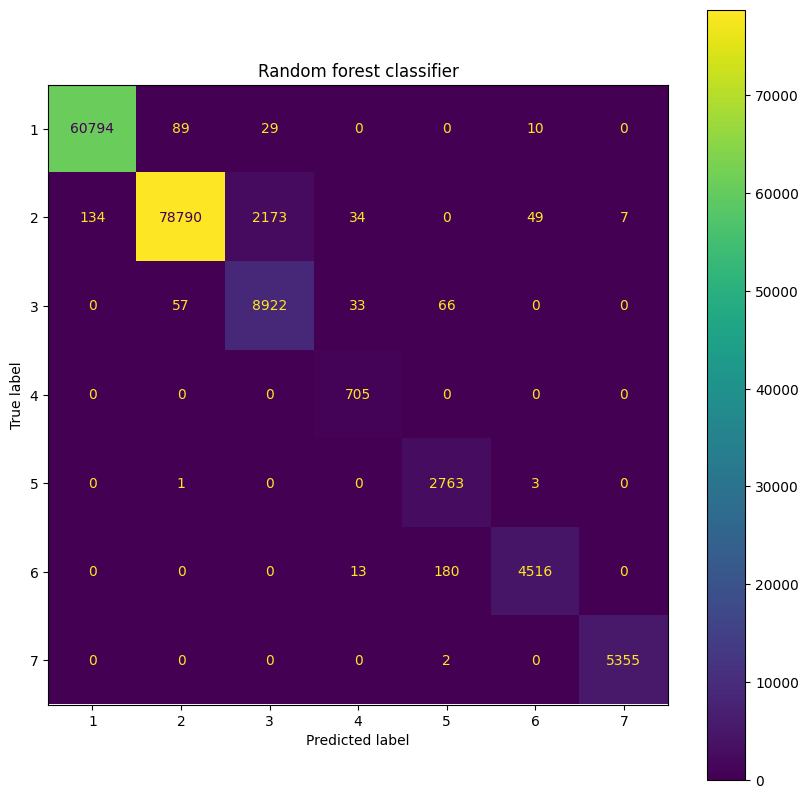

In [151]:
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title(f'Random forest classifier')
ConfusionMatrixDisplay.from_estimator(clf.best_estimator_, X_test,y_test, ax=ax)  
plt.show

In [29]:
# LogisticRegression()
pipe = Pipeline([('undersampler', RandomUnderSampler()), ('transformer', ct), ('classifier', LogisticRegression())])
pipe.fit(X_train,y_train)
pipe.score(X_test,y_test)

0.998330550918197

<function matplotlib.pyplot.show(close=None, block=None)>

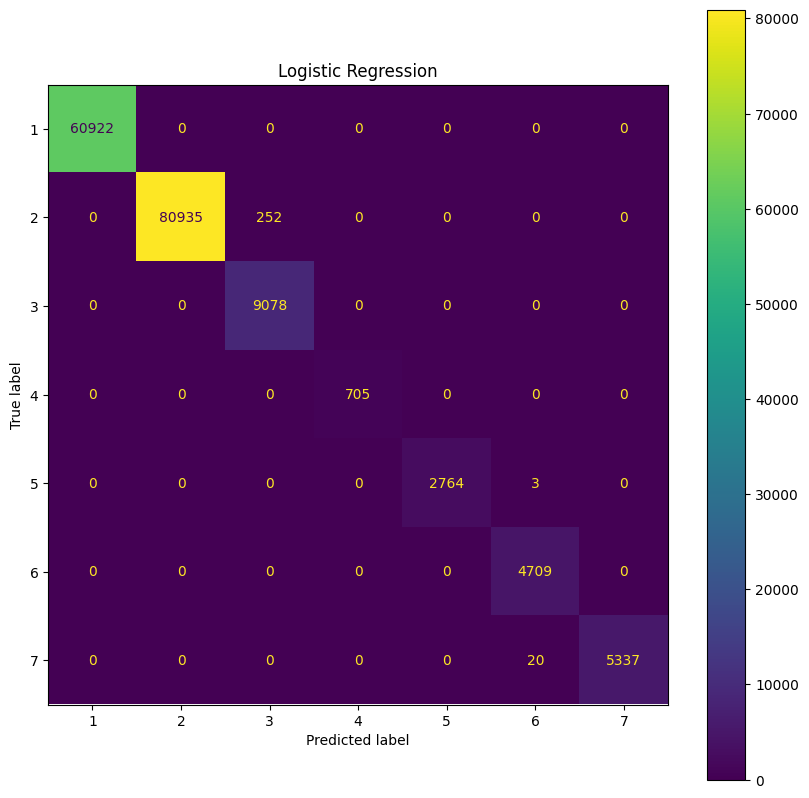

In [30]:
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title(f'Logistic Regression')
ConfusionMatrixDisplay.from_estimator(pipe, X_test,y_test, ax=ax)  
plt.show

In [15]:
# MLPClassifier()
train = []
test = []
neurons = range(5, 10)
for n in neurons:
    clf = MLPClassifier(hidden_layer_sizes = (n, n), random_state=17)
    clf.fit(X_train, y_train)
    train.append(clf.score(X_train, y_train))
    test.append(clf.score(X_test, y_test))
    print(f'{n} neurons done')

5 neurons done
6 neurons done
7 neurons done
8 neurons done
9 neurons done


Text(0, 0.5, 'Accuracy')

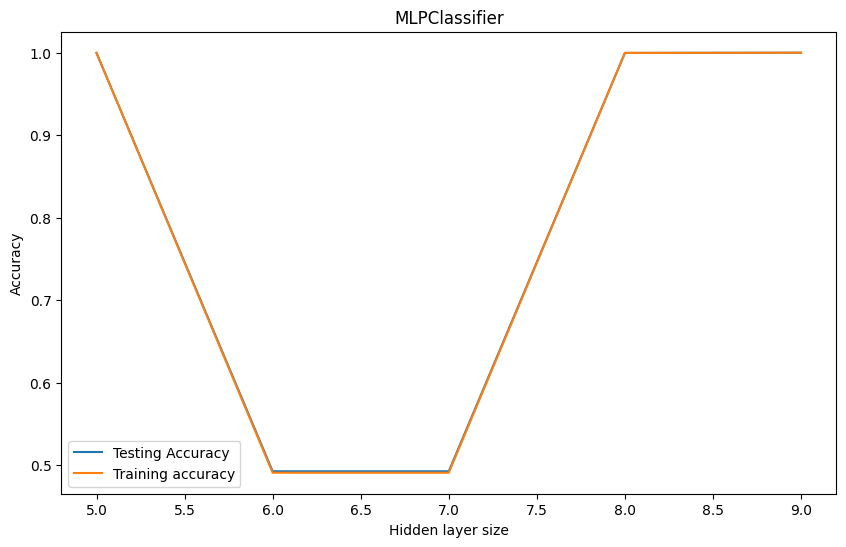

In [17]:
plt.figure(figsize=(10,6))
plt.title('MLPClassifier')
plt.plot(neurons, test, label='Testing Accuracy')
plt.plot(neurons, train, label='Training accuracy')
plt.legend()
plt.xlabel('Hidden layer size')
plt.ylabel('Accuracy')

In [18]:
test

[0.9997996661101837,
 0.49286386401578386,
 0.49286386401578386,
 0.9997814539383821,
 1.0]

In [44]:
pipe = Pipeline([('undersampler', RandomUnderSampler()), ('transformer', ct), ('classifier', MLPClassifier(hidden_layer_sizes = (9, 9), random_state=17, max_iter=500))])
pipe.fit(X_train,y_train)
cross_val_score(pipe, X, y, scoring='accuracy', n_jobs = -1, cv=10, error_score="raise" )

array([1.        , 1.        , 0.99949006, 1.        , 1.        ,
       0.99928972, 1.        , 0.99990894, 0.9955562 , 0.99992715])

<function matplotlib.pyplot.show(close=None, block=None)>

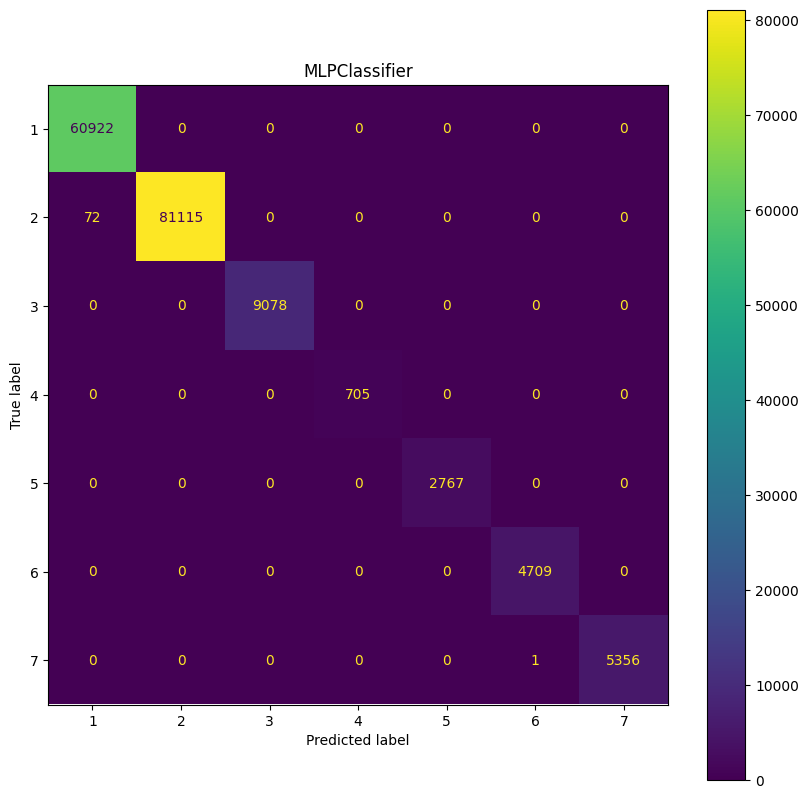

In [36]:
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title(f'MLPClassifier')
ConfusionMatrixDisplay.from_estimator(pipe, X_test, y_test, ax=ax)  
plt.show

# Выводы

Все классификаторы показали себя исключительно при обработке датасета. На это может быть несколько причин:
1. Данных в датасете настолько много, что даже балансируя классы с помощью андерсемплинга,их остается более чем достаточно, чтобы отлично обучить модель
2. На некоторых графиках можно заметить четко выделенные границы различных кластеров, что при наличии большого количества данных, как это было упомянуто в предыдущем пункте, позволяет классификаторам с легкостью давать верный ответ

По результатам тестов лучше всего себя показал наивный байесовский классификатор и многослойный персептрон с двумя скрытыми слоями по девять нейронов в каждом.